In [1]:
# Import Packages

#Admin
import time
from datetime import datetime
%autocall 1

# API/Web Scraping
import requests
from bs4 import BeautifulSoup

# Analysis
import pandas as pd
pd.options.display.max_rows=999
pd.options.display.max_columns=999
import numpy as np

# Data Visualization
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# Class Balancing
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTEENN, SMOTETomek
from imblearn.under_sampling import NearMiss, EditedNearestNeighbours, TomekLinks
from sklearn.utils import resample

# Modeling and Model Evaluation
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import BernoulliNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier, ExtraTreesClassifier
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix, classification_report
from xgboost import XGBClassifier
from imblearn.ensemble import BalancedBaggingClassifier

Automatic calling is: Smart


In [2]:
# Download and Read in SEC Enforcement Cases Reports

secstats2016 = pd.read_excel('./secstats2016.xlsx')

secstats2015 = pd.read_excel('./secstats2015.xlsx')

secstats2014 = pd.read_excel('./secstats2014.xlsx')

secstats2013 = pd.read_excel('./secstats2013.xlsx')

secstats2012 = pd.read_excel('./secstats2012.xlsx')

secstats2011 = pd.read_excel('./secstats2011.xlsx')

secstats2010 = pd.read_excel('./secstats2010.xlsx')

secstats2009 = pd.read_excel('./secstats2009.xlsx')

secstats2008 = pd.read_excel('./secstats2008.xlsx')

In [3]:
# Clean Up Target Data

secstats2008.rename(columns={'Unnamed: 3' : 'Release_No', 'Unnamed: 4' : 'Date'}, inplace=True)

secstats2009.rename(columns={'Unnamed: 3' : 'Release_No', 'Unnamed: 4' : 'Date'}, inplace=True)

secstats2010.rename(columns={'Unnamed: 3' : 'Release_No', 'Unnamed: 4' : 'Date'}, inplace=True)

secstats2011.rename(columns={'Reference_No' : 'Release_No'}, inplace=True)

secstats2012.rename(columns={'Unnamed: 3' : 'Release_No', 'Unnamed: 4' : 'Date'}, inplace=True)

secstats2013.rename(columns={'Unnamed: 3' : 'Release_No', 'Unnamed: 4' : 'Date'}, inplace=True)

In [4]:
# Concatenante all excel files to create one target data set

target = pd.concat([secstats2008, secstats2009, secstats2010, secstats2011, 
         secstats2012,secstats2013, secstats2014, secstats2015, secstats2016], axis=0)

In [5]:
target.head()

,Defendant,Classification,Action,Release_No,Date
0,"SEC v. Kevin James Dunn, Jr.",Broker-Dealer,NaN,LR-20323,10/04/2007
1,"In the Matter of Morgan Stanley & Co., Inc.",Broker-Dealer,NaN,34-56634,10/10/2007
2,"SEC v. Robert A. Loffredi, et al.",Broker-Dealer,NaN,LR-20343,10/19/2007
3,In the Matter of Charles N. Watson,Broker-Dealer,NaN,34-56737,11/02/2007
4,In the Matter of John R. Glushko,Broker-Dealer,NaN,34-57435,11/14/2007


After this, I manually looked up the CIK ID number for names in target.Defendant 
in order to web scrape the SEC website for Filings data.  I saved that information into 
SEC_cases.csv.  This pared down my target list to 175 corporate defendants.

In [6]:
SEC_cases = pd.read_csv('./SEC_cases.csv', index_col=0)

In [7]:
SEC_cases.rename(columns={'CIK': 'cik'}, inplace=True)

In [8]:
SEC_cases.columns

Index(['Defendant', 'cik', 'Classification', 'Release_No', 'Date', 'SEC',
       'Year', 'Inc', 'LLC'],
      dtype='object')

In [9]:
SEC_cases.head()

,Defendant,cik,Classification,Release_No,Date,SEC,Year,Inc,LLC
0,"Kevin James Dunn, Jr.",NaN,Broker-Dealer,lr20323,10/04/2007,1,2007,"['""MetLife""']",[]
1,Robert A. Loffred.,NaN,Broker-Dealer,lr20343,10/19/2007,1,2007,['Raymond Financial'],[]
2,Sidney Mondschei.,NaN,Broker-Dealer,lr20531,12/06/2007,1,2007,[],[]
3,Darryl A. Goldstei.,NaN,Broker-Dealer,lr20403,12/18/2007,1,2007,['MSDW'],[]
4,Mark Barbera,NaN,Broker-Dealer,lr20458,02/14/2008,1,2008,['TWCO'],[]


In [10]:
# Checking for Data types to see what I need to transform

SEC_cases.dtypes

Defendant          object
cik               float64
Classification     object
Release_No         object
Date               object
SEC                 int64
Year                int64
Inc                object
LLC                object
dtype: object

In [11]:
# Drop Defendants without a CIK ID number

SEC_cases_with_CIK = SEC_cases.dropna()

In [12]:
SEC_cases_with_CIK.cik = SEC_cases_with_CIK.cik.astype(int)

/Users/jessicachace/anaconda3/lib/python3.6/site-packages/pandas/core/generic.py:4401: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


In [13]:
SEC_cases_with_CIK.shape

(175, 9)

I found a GitHub repo called CorpWatch with data pulled from the SEC website containing many of the features
I was interested in modeling, so I incorporated this data as my not_target data.  
I concatenated a few of their data sets to build out a more fulsome not_target data set
that could also match to my target data set using the CIK ID number.

In [14]:
companies = pd.read_csv('./companies.csv', sep='\t', index_col=0)
companies.head()

/Users/jessicachace/anaconda3/lib/python3.6/site-packages/numpy/lib/arraysetops.py:472: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


,cw_id,cik,company_name,source_type,source_id
row_id,,,,,
781188,781188,13.0,CORPORATE INCOME FUND SEVENTY NINTH SHORT TERM...,filers,955918
1,1,20.0,K TRON INTERNATIONAL INC,filers,35791
2,2,1750.0,AAR CORP,filers,40788
3,3,1800.0,ABBOTT LABORATORIES,filers,1214762
4,4,1841.0,ABEL NOSER CORP,filers,8286


In [15]:
company_names = pd.read_csv('./company_names.csv', index_col=0)
company_names.head()

,cw_id,company_name,date,source,source_row_id,country_code,subdiv_code,min_year,max_year,most_recent
name_id,,,,,,,,,,
1,1,K TRON INTERNATIONAL INC,2003-10-21,filer_match_name,35791,US,NJ,2003,2011,1
2,2,AAR CORP,2003-12-10,filer_match_name,40788,US,DE,2003,2018,1
3,3,ABBOTT LABORATORIES,2003-03-18,filer_match_name,1214762,US,IL,2003,2018,1
4,4,ABEL NOSER CORP,2003-03-07,filer_match_name,8286,US,NY,2003,2003,1
5,4,ABEL/NOSER CORP,2004-02-27,filer_match_name,73619,US,NY,2004,2016,1


In [16]:
companies_with_CIK = companies.dropna()

companies_with_CIK.cik = companies_with_CIK.cik.astype(int)

/Users/jessicachace/anaconda3/lib/python3.6/site-packages/pandas/core/generic.py:4401: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[name] = value


In [17]:
# Adding some data from the CorpWatch sets to my target dataset

corpwatch = pd.merge(SEC_cases_with_CIK, companies_with_CIK, how='left', on='cik')

In [18]:
corpwatch.dropna(inplace=True)

len(corpwatch)

corpwatch.cw_id = corpwatch.cw_id.astype(int)

In [19]:
corpwatch.dtypes

Defendant          object
cik                 int64
Classification     object
Release_No         object
Date               object
SEC                 int64
Year                int64
Inc                object
LLC                object
cw_id               int64
company_name       object
source_type        object
source_id         float64
dtype: object

In [20]:
# Adding even more info from CorpWatch dataset to my target dataset

corpwatch = pd.merge(corpwatch, company_names, how='left', on='cw_id')

In [21]:
# Getting a Sense of my Target Data Set

corpwatch.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 175 entries, 0 to 174
Data columns (total 22 columns):
Defendant         175 non-null object
cik               175 non-null int64
Classification    175 non-null object
Release_No        175 non-null object
Date              175 non-null object
SEC               175 non-null int64
Year              175 non-null int64
Inc               175 non-null object
LLC               175 non-null object
cw_id             175 non-null int64
company_name_x    175 non-null object
source_type       175 non-null object
source_id         175 non-null float64
company_name_y    97 non-null object
date              97 non-null object
source            97 non-null object
source_row_id     97 non-null float64
country_code      72 non-null object
subdiv_code       71 non-null object
min_year          97 non-null float64
max_year          97 non-null float64
most_recent       97 non-null float64
dtypes: float64(5), int64(4), object(13)
memory usage: 31.4+ KB


In [22]:
# How many null values do I have in my target data set

corpwatch.isnull().sum()

Defendant           0
cik                 0
Classification      0
Release_No          0
Date                0
SEC                 0
Year                0
Inc                 0
LLC                 0
cw_id               0
company_name_x      0
source_type         0
source_id           0
company_name_y     78
date               78
source             78
source_row_id      78
country_code      103
subdiv_code       104
min_year           78
max_year           78
most_recent        78
dtype: int64

In [23]:
# Preparing to stitch together my target and not_target data sets

corpwatch_v2 = corpwatch.drop(['Defendant', 'Classification', 'Release_No', 
                                             'Date', 'Year', 'Inc', 'LLC', 
                                             'source_type'], axis=1)

In [24]:
corpwatch_v2.drop('SEC', axis=1, inplace=True)

In [25]:
# Building out my not_target dataset

not_target_all = pd.merge(company_names, companies_with_CIK, how='left', on='cw_id')

In [26]:
not_target_all.shape

(65499, 14)

In [27]:
# Trying to align my target and not_target datasets

not_target_all.drop('source_type', axis=1, inplace=True)

In [28]:
# Checking columns for alignment before concatenating

print(f"Not_Target Columns: {not_target_all.columns}")
print(len(not_target_all.columns))
print()
print(f"Target Columns: {corpwatch_v2.columns}")
print(len(corpwatch_v2.columns))

Not_Target Columns: Index(['cw_id', 'company_name_x', 'date', 'source', 'source_row_id',
       'country_code', 'subdiv_code', 'min_year', 'max_year', 'most_recent',
       'cik', 'company_name_y', 'source_id'],
      dtype='object')
13

Target Columns: Index(['cik', 'cw_id', 'company_name_x', 'source_id', 'company_name_y', 'date',
       'source', 'source_row_id', 'country_code', 'subdiv_code', 'min_year',
       'max_year', 'most_recent'],
      dtype='object')
13


In [29]:
# Getting a sense of the shapes of my target, not_target data sets

print(f"Shape of Target: {corpwatch_v2.shape}")
print()
print(f"Shape of Not_Target: {not_target_all.shape}")

Shape of Target: (175, 13)

Shape of Not_Target: (65499, 13)


In [30]:
# Subsetting my target dataset OUT of my not_target_all dataset

not_target = not_target_all[~not_target_all.index.isin(corpwatch_v2.index)]

In [31]:
# Ensuring that target set is out of not_target set

print(f"Shape of Not Target: 65,499 - 175 = {len(not_target)}")

Shape of Not Target: 65,499 - 175 = 65324


In [32]:
# Setting up my prediction columns for target, not_target datasets

not_target['Indicted'] = 0

corpwatch_v2['Indicted'] = 1

/Users/jessicachace/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [33]:
'''Concatenating my target, not_target on top of each other now that they have 
their prediction columns'''

data = pd.concat([not_target, corpwatch_v2], axis=0, sort=True)

In [34]:
data

,Indicted,cik,company_name_x,company_name_y,country_code,cw_id,date,max_year,min_year,most_recent,source,source_id,source_row_id,subdiv_code
175,0,7195,ARGUS INVESTORS COUNSEL INC,ARGUS INVESTORS COUNSEL INC,US,128,2003-11-25,2018.0,2003.0,1.0,filer_match_name,69407.0,69407.0,NY
176,0,7286,ARIZONA PUBLIC SERVICE CO,ARIZONA PUBLIC SERVICE CO,US,129,2003-11-05,2018.0,2003.0,1.0,filer_match_name,57585.0,57585.0,AZ
177,0,7323,ENTERGY ARKANSAS INC,ENTERGY ARKANSAS INC,US,130,2003-10-02,2018.0,2003.0,1.0,filer_match_name,49273.0,49273.0,AR
178,0,7332,SOUTHWESTERN ENERGY CO,SOUTHWESTERN ENERGY CO,US,131,2003-01-17,2018.0,2003.0,1.0,filer_match_name,1213053.0,1213053.0,AR
179,0,7426,ARMSTRONG ASSOCIATES INC,ARMSTRONG ASSOCIATES INC,US,132,2003-10-31,2013.0,2003.0,1.0,filer_match_name,40638.0,40638.0,TX
180,0,7431,ARMSTRONG WORLD INDUSTRIES INC,ARMSTRONG WORLD INDUSTRIES INC,US,133,2003-10-01,2018.0,2003.0,1.0,filer_match_name,38335.0,38335.0,PA
181,0,7470,NATEXIS BLEICHROEDER INC,NATEXIS BLEICHROEDER INC,US,134,2004-03-01,2007.0,2004.0,1.0,filer_match_name,77796.0,77796.0,NY
182,0,7470,NATIXIS BLEICHROEDER INC,NATEXIS BLEICHROEDER INC,US,134,2008-02-29,2009.0,2008.0,1.0,filer_match_name,77796.0,414572.0,NY
183,0,7470,NATIXIS BLEICHROEDER LLC,NATEXIS BLEICHROEDER INC,US,134,2010-03-15,2011.0,2010.0,1.0,filer_match_name,77796.0,609104.0,DE
184,0,7470,NATIXIS SECURITIES AMERICAS LLC,NATEXIS BLEICHROEDER INC,US,134,2012-02-28,2017.0,2012.0,1.0,filer_match_name,77796.0,776536.0,DE


In [35]:
# Getting a sense of my dataset

data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65499 entries, 175 to 174
Data columns (total 14 columns):
Indicted          65499 non-null int64
cik               65499 non-null int64
company_name_x    65499 non-null object
company_name_y    65421 non-null object
country_code      37380 non-null object
cw_id             65499 non-null int64
date              65421 non-null object
max_year          65421 non-null float64
min_year          65421 non-null float64
most_recent       65421 non-null float64
source            65421 non-null object
source_id         65499 non-null float64
source_row_id     65421 non-null float64
subdiv_code       36085 non-null object
dtypes: float64(5), int64(3), object(6)
memory usage: 7.5+ MB


In [36]:
# Preprocessing/Feature Engineering before modeling

# Drop columns that won't contribute to predictions

data.drop(['company_name_x', 'company_name_y', 'source', 'date'], axis=1, inplace=True)

# Fill missing locations with "UI" which stands for Unidentified - some might have been 
# intentionally left blank by filers

data.country_code = data['country_code'].fillna('UI')
data.subdiv_code = data['subdiv_code'].fillna('UI')

# Label Encode locations for modeling purposes

encode = LabelEncoder()
data['country_code'] = encode.fit_transform(data['country_code'])
data['subdiv_code'] = encode.fit_transform(data['subdiv_code'])

# Make a new column that tracks how many years active a corporation was

data['Years_Active'] = data['max_year'] - data['min_year']

In [37]:
data.isnull().sum()

Indicted          0
cik               0
country_code      0
cw_id             0
max_year         78
min_year         78
most_recent      78
source_id         0
source_row_id    78
subdiv_code       0
Years_Active     78
dtype: int64

In [38]:
# Fill nulls with 0 - there's so few of them at this point, it won't make a huge difference

data.fillna(0, inplace=True)

In [39]:
data.isnull().sum()

Indicted         0
cik              0
country_code     0
cw_id            0
max_year         0
min_year         0
most_recent      0
source_id        0
source_row_id    0
subdiv_code      0
Years_Active     0
dtype: int64

I then used the CIK ID number to scrape corporate filings from the SEC website to include
in my modeling.  The below cell is the code I used, however, it is commented out so as not to
re-pull the data, which took over four hours to complete.  I stored the results in a list.

In [40]:
# # Scrape SEC website for information on corporate filings

# edgar = []

# for index, row in data.iterrows():
    
#     cells=[]
#     try:
#         cik = int(row['cik'])
#         print(cik)
#         URL = f"https://www.sec.gov/cgi-bin/browse-edgar?action=getcompany&CIK={cik}"
#         res = requests.get(URL)
#         soup = BeautifulSoup(res.content, 'lxml')
#         table = soup.find('table', {'class': 'tableFile2'})
        
#         for row in table.find_all('tr')[1:]:
#             cells.append( row.find('td').text)
#     except:
#         res.raise_for_status
#     print(URL, res.status_code)

#     edgar.append(cells)

# data['Filings'] = edgar

# data.to_csv('./Data_with-Filings.csv', sep=',')

In [41]:
data = pd.read_csv('./Data_with-Filings.csv', index_col=0)

In [42]:
data.head()

,Indicted,cik,country_code,cw_id,max_year,min_year,most_recent,source_id,source_row_id,subdiv_code,Filings
0,0,7195,63,128,2018.0,2003.0,1.0,69407.0,69407.0,39,"['13F-HR', '13F-HR', '13F-HR', '13F-HR', '13F-..."
1,0,7286,63,129,2018.0,2003.0,1.0,57585.0,57585.0,4,"['8-K', '8-K', '10-Q', '8-K', 'UPLOAD', 'S-3AS..."
2,0,7323,63,130,2018.0,2003.0,1.0,49273.0,49273.0,3,"['8-K', '8-K', '8-K', '424B2', 'FWP', '424B3',..."
3,0,7332,63,131,2018.0,2003.0,1.0,1213053.0,1213053.0,3,"['8-K', '11-K', '8-K', '4', '4', '4', '4', '4'..."
4,0,7426,63,132,2013.0,2003.0,1.0,40638.0,40638.0,51,"['N-8F ORDR', 'N-8F', 'NSAR-B', 'N-PX', '24F-2..."


In [43]:
# # Dummify, concat, then drop, the contents of the data.Filings column for modeling purposes
# (Notebook gets really unstable with this cell, so reading in a cleaned up version of this)

# filings = pd.get_dummies(data.Filings.apply(pd.Series).stack()).sum(level=0)

# data = pd.concat([data, filings], axis=1)

# data.drop('Filings', axis=1, inplace=True)

In [51]:
data = pd.read_csv('./Data With Filings_v2', index_col=0)
data

,Indicted,cik,country_code,cw_id,max_year,min_year,most_recent,source_id,source_row_id,subdiv_code,1,1-A,1-A POS,1-A-W,1-A/A,1-E,1-E/A,1-K,1-Z,1/A,10-12B,10-12B/A,10-12G,10-12G/A,10-C,10-D,10-D/A,10-K,10-K/A,10-K405,10-K405/A,10-KSB,10-KSB/A,10-KT,10-KT/A,10-Q,10-Q/A,10-QT,10-QT/A,10KSB,10KSB/A,10KSB40,10KSB40/A,10QSB,10QSB/A,10SB12B,10SB12B/A,10SB12G,10SB12G/A,11-K,11-K/A,12G3-2B,12G32BR,13F-E,13F-HR,13F-HR/A,13F-NT,13F-NT/A,13FCONP,144,144/A,15-12B,15-12B/A,15-12G,15-12G/A,15-15D,15-15D/A,15F-12B,15F-12B/A,15F-12G,15F-12G/A,15F-15D,15F-15D/A,18-K,18-K/A,19B-4E,2-A,2-A/A,2-AF,2-E,20-F,20-F/A,20FR12B,20FR12B/A,20FR12G,20FR12G/A,24F-2NT,24F-2NT/A,25,25-NSE,25-NSE/A,25/A,253G2,253G3,3,3/A,305B2,305B2/A,34-12H,35-CERT,39-304D,4,4/A,40-17F1,40-17F2,40-17F2/A,40-17G,40-17G/A,40-17GCS,40-202A,40-202A/A,40-206A,40-206A/A,40-24B2,40-24B2/A,40-33,40-33/A,40-6B,40-6B/A,40-6C,40-6C/A,40-8B25,40-8F-2,40-8F-2/A,40-8F-L,40-8F-M,40-8F-M/A,40-APP,40-APP/A,40-F,40-F/A,40-OIP,40-OIP/A,40FR12B,40FR12G,40FR12G/A,424A,424B1,424B2,424B3,424B4,424B5,424B7,424B8,424H,424H/A,425,485A24E,485APOS,485B24E,485B24F,485BPOS,485BXT,486APOS,486BPOS,487,497,497AD,497H2,497J,497K,497K3B,5,5/A,6-K,6-K/A,6B NTC,6B ORDR,8-A12B,8-A12B/A,8-A12G,8-A12G/A,8-B12B,8-K,8-K/A,8-K12B,8-K12G3,8-K12G3/A,8-K15D5,8-M,8F-2 NTC,8F-2 ORDR,9-M,ABS-15G,ABS-15G/A,ABS-EE,ABS-EE/A,ADN-MTL,ADV-E,ADV-H-C,ADV-H-T,ADV-NR,ANNLRPT,APP NTC,APP ORDR,APP WD,APP WD/A,APP WDG,ARS,AW,AW WD,C,CB,CB/A,CERT,CERTAMX,CERTCBO,CERTNAS,CERTNYS,CERTPAC,CORRESP,CT ORDER,D,D/A,DEF 14A,DEF 14C,DEFA14A,DEFA14C,DEFC14A,DEFM14A,DEFM14C,DEFN14A,DEFR14A,DEFR14C,DEFS14A,DEL AM,DFAN14A,DFRN14A,DOS,DRS,DRS/A,DRSLTR,DSTRBRPT,DSTRBRPT/A,EFFECT,F-1,F-1/A,F-10,F-10/A,F-10EF,F-10POS,F-1MEF,F-3,F-3/A,F-3ASR,F-3D,F-3DPOS,F-3MEF,F-4,F-4 POS,F-4/A,F-6,F-6 POS,F-6/A,F-6EF,F-7,F-7 POS,F-7/A,F-80,F-80/A,F-9,F-9 POS,F-9/A,F-N,F-N/A,F-X,F-X/A,FOCUSN,FOCUSN/A,FWP,G-405,G-405/A,G-405N,G-405N/A,G-FIN,G-FIN/A,G-FINW,IRANNOTICE,MA,MA-A,MA-I,MA-I/A,MA-W,MA/A,MSD,MSD/A,MSDW,N-1/A,N-14,N-14 8C,N-14 8C/A,N-14/A,N-14AE,N-18F1,N-1A,N-1A/A,N-2,N-2/A,N-23C-2,N-23C-2/A,N-23C3A,N-23C3A/A,N-23C3B,N-27D-1,N-2MEF,N-3,N-30B-2,N-30D,N-30D/A,N-4,N-4/A,N-54A,N-54C,N-6,N-6/A,N-6F,N-8A,N-8A/A,N-8B-2,N-8B-2/A,N-8F,N-8F NTC,N-8F ORDR,N-8F/A,N-CR,N-CSR,N-CSR/A,N-CSRS,N-CSRS/A,N-MFP,N-MFP/A,N-MFP1,N-MFP1/A,N-MFP2,N-MFP2/A,N-PX,N-PX/A,N-Q,N-Q/A,N14AE24,NO ACT,NSAR-A,NSAR-A/A,NSAR-AT,NSAR-AT/A,NSAR-B,NSAR-B/A,NSAR-BT,NSAR-U,NSAR-U/A,NT 10-D/A,NT 10-K,NT 10-K/A,NT 10-Q,NT 10-Q/A,NT 11-K,NT 20-F,NT 20-F/A,NT N-MFP,NT N-MFP1,NT N-MFP2,NT-NCSR,NT-NCSR/A,NT-NSAR,NT-NSAR/A,NTFNCSR,NTFNSAR,NTN 10D,NTN 10K,NTN 10Q,NTN 20F,OIP NTC,OIP ORDR,POS 8C,POS AM,POS AMI,POS EX,POS462B,POS462C,POSASR,PRE 14A,PRE 14C,PREC14A,PREC14C,PREM14A,PREM14C,PREN14A,PRER14A,PRER14C,PRES14A,PRRN14A,PX14A6G,PX14A6N,QRTLYRPT,QUALIF,REG-NR,REG-NR/A,REGDEX,REGDEX/A,REVOKED,RW,RW WD,S-1,S-1/A,S-11,S-11/A,S-1MEF,S-2,S-3,S-3/A,S-3ASR,S-3D,S-3DPOS,S-3MEF,S-4,S-4 POS,S-4/A,S-4EF,S-4MEF,S-6,S-6/A,S-6EL24,S-6EL24/A,S-8,S-8 POS,S-B,S-B/A,S-BMEF,SB-1,SB-1/A,SB-2,SB-2/A,SB-2MEF,SC 13D,SC 13D/A,SC 13E1/A,SC 13E3,SC 13E3/A,SC 13E4,SC 13E4/A,SC 13G,SC 13G/A,SC 14D1,SC 14D1/A,SC 14D9,SC 14D9/A,SC 14F1,SC 14F1/A,SC TO-C,SC TO-I,SC TO-I/A,SC TO-T,SC TO-T/A,SC14D1F,SC14D1F/A,SC14D9C,SC14D9F,SC14D9F/A,SD,SD/A,SE,SF-1,SF-1/A,SF-3,SF-3/A,SP 15D2,STOP ORDER,SUPPL,T-3,T-3/A,TA-1,TA-1/A,TA-2,TA-2/A,TA-W,TACO,TH,TTW,U-1,U-1/A,U-12-IB,U-57,U-6B-2,UNDER,UPLOAD,WDL-REQ,X-17A-5,X-17A-5/A
0,0,7195,63,128,2018.0,2003.0,1.0,69407.0,69407.0,39,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0

In [52]:
data['Years_Active'] = data['max_year'] - data['min_year']

In [53]:
# Masking my target, not_target sets as Indicted, Not_Indicted

Indicted = data[data['Indicted'] == 1]

Not_Indicted = data[data['Indicted'] == 0]

In [54]:
# Exploratory Data Analysis

Indicted_10Q = Indicted[Indicted['10-Q'] > 0]

Indicted_10K = Indicted[Indicted['10-K'] > 0]

Indicted_8K = Indicted[Indicted['8-K'] > 0]

Not_Indicted_10Q = Not_Indicted[Not_Indicted['10-Q'] > 0]

Not_Indicted_10K = Not_Indicted[Not_Indicted['10-K'] > 0]

Not_Indicted_8K = Not_Indicted[Not_Indicted['8-K'] > 0]

In [ ]:
# fig = plt.figure(figsize=(20,15))

# plt.subplot(3,2,1)
# Indicted_10K = Indicted[Indicted['10-K'] > 0]
# plt.title('10-Ks for Corporations Indicted')

# plt.subplot(3,2,2)
# Not_Indicted_10K = Not_Indicted[Not_Indicted['10-K'] > 0]
# plt.title('10-Ks for Corporations Not Indicted')

# plt.subplot(3, 2, 3)
# Indicted_8K = Indicted[Indicted['8-K'] > 0]
# plt.title('8-Ks for Corporations Indicted')

# plt.subplot(3, 2, 4)
# Not_Indicted_8K = Not_Indicted[Not_Indicted['8-K'] > 0]
# plt.title('8-Ks for Corporations Not Indicted')

# plt.subplot(3, 2, 5)
# Indicted_10Q['10-Q'].sort_values(ascending=False).plot(kind='bar')
# plt.title('10-Qs for Corporations Indicted')

# plt.subplot(3, 2, 6)
# Not_Indicted_10Q['10-Q'].sort_values(ascending=False).plot(kind='bar')
# plt.title('10-Qs for Corporations Not Indicted');

In [56]:
# Comparison of Years_Active between Indicted, Not_Indicted

print(f"Indicted Stats: {Indicted['Years_Active'].describe()}")
print()
print(f"Not_Indicted Stats: {Not_Indicted['Years_Active'].describe()}")

Indicted Stats: count    175.000000
mean       3.320000
std        4.627554
min        0.000000
25%        0.000000
50%        0.000000
75%        6.000000
max       15.000000
Name: Years_Active, dtype: float64

Not_Indicted Stats: count    65324.000000
mean         6.738473
std          4.803204
min          0.000000
25%          3.000000
50%          6.000000
75%         11.000000
max         15.000000
Name: Years_Active, dtype: float64


In [59]:
# Comparison of Years_Active, 10-Qs, 10-Ks between Indicted, Not_Indicted

print("Indicted 10-Qs, 10-Ks, and Years Active, Descending by 10-Q")
print(Indicted[['10-Q', '10-K', 'Years_Active']].sort_values('10-Q', ascending=False).head(10))
print()
print("Not_Indicted, 10-Qs, 10-Ks, and Years Active, Descending by 10-Q")
print(Not_Indicted[['10-Q', '10-K', 'Years_Active']].sort_values('10-Q', ascending=False).head(10))

Indicted 10-Qs, 10-Ks, and Years Active, Descending by 10-Q
       10-Q  10-K  Years_Active
65481  14.0   5.0           8.0
65482  14.0   5.0           2.0
65390  13.0   4.0          11.0
65396  10.0   3.0          15.0
65359   9.0   2.0           2.0
65358   9.0   2.0           3.0
65360   9.0   2.0           3.0
65341   9.0   3.0           4.0
65340   9.0   3.0           2.0
65339   9.0   3.0           3.0

Not_Indicted, 10-Qs, 10-Ks, and Years Active, Descending by 10-Q
       10-Q  10-K  Years_Active
44082  30.0   9.0          14.0
44131  30.0  10.0          14.0
53888  30.0  10.0          12.0
4645   30.0  10.0          15.0
53895  30.0  10.0          12.0
3254   30.0  10.0          13.0
16001  29.0  10.0          15.0
42252  29.0  10.0          15.0
5916   29.0   9.0          15.0
44358  28.0   9.0          14.0


In [ ]:
# pd.crosstab(df.column_x, df.column_y)

In [60]:
# Feature Selection

from sklearn.feature_selection import  SelectKBest, f_regression, f_classif

# Define target
target = 'Indicted'

# Instantiate selector
selector = SelectKBest(score_func=f_classif, k=10)

# Subset Features
train_features = data.drop(['Indicted', 'cw_id', 'cik', 'source_id',
                           'source_row_id'], axis=1).select_dtypes(include=['number'])

# Subset Target
train_target = data[target]

# Fit selector
selector.fit(train_features, train_target)

# Extract best feature indexes
best_features = selector.get_support(indices=True)

# convert indexes to feature names
features = list(train_features.columns[selector.get_support(indices = True)])
print(features)

['max_year', 'min_year', 'most_recent', '2-A', 'ADV-H-T', 'DEFR14C', 'DOS', 'SC 14F1/A', 'STOP ORDER', 'UPLOAD']


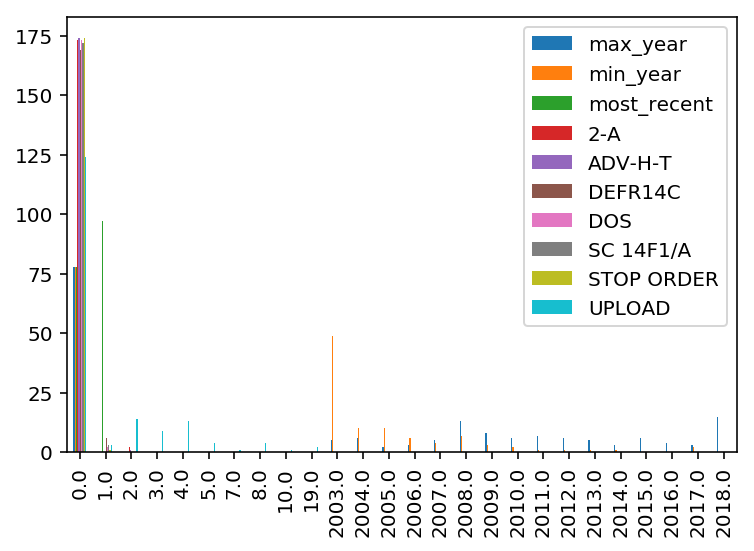

In [74]:
# Indicted[features].apply(pd.value_counts).plot(kind='bar')

In [75]:
# Downsample Majority Class

Not_Indicted_downsampled = resample(Not_Indicted, replace=False, 
                                    n_samples=5000, random_state=240)
df_downsample = pd.concat([Not_Indicted_downsampled, Indicted])


X = df_downsample.drop(['Indicted'], axis=1).values
y = df_downsample.Indicted.values

In [76]:
# Train-Train-Split on Data Set

from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.preprocessing import PolynomialFeatures, StandardScaler

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=42)

# Standard Scaler

ss = StandardScaler()
X_train = ss.fit_transform(X_train)
X_test = ss.transform(X_test)

In [77]:
# Try to Balance Classes with SMOTEENN

from sklearn.metrics import recall_score
from imblearn.combine import SMOTEENN

# enn = EditedNearestNeighbours(n_neighbors=5)
# sm = SMOTEENN(smote= SMOTE(k_neighbors=5, ratio='minority'), 
#                  enn=EditedNearestNeighbours(ratio='majority', n_neighbors=15),
#                  random_state=6271)

sm = SMOTEENN()

X_train, y_train = sm.fit_sample(X_train, y_train)

In [78]:
# RandomForestClassifier

from sklearn.ensemble import BaggingClassifier, RandomForestClassifier, ExtraTreesClassifier
from sklearn.pipeline import Pipeline

rf = RandomForestClassifier()

rf_pipe = Pipeline([
    ('ss', ss),
    ('rf', rf)
])

params = {'rf__n_estimators' : [10, 15, 20],
          'rf__max_depth' : [None, 2, 3, 4, 5],
          'rf__n_jobs' : [-1]}

rf_gs = GridSearchCV(rf_pipe, param_grid=params, cv=5, scoring='roc_auc')
rf_gs.fit(X_train, y_train)

best_rf_gs = rf_gs.best_estimator_

rf_gs_train = best_rf_gs.score(X_train, y_train)
rf_gs_test = best_rf_gs.score(X_test, y_test)

In [79]:
# XGBoost Classifier

gs_params = {
    'max_depth':[1, 2, 3, 4, 5],
    'n_estimators':range(1, 10, 1),
    'learning_rate':np.logspace(-5,0,5),
    'silent' : [False],
    'booster' : ['gbtree', 'gblinear', 'dart'],
    'n_jobs' : [-1]
}

xgb_gs = GridSearchCV(XGBClassifier(), gs_params, cv=3, verbose=1, scoring='roc_auc')

xgb_gs = xgb_gs.fit(X_train, y_train)

best_xgb_gs = xgb_gs.best_estimator_

xgb_gs_train = best_xgb_gs.score(X_train, y_train)
xgb_gs_test = best_xgb_gs.score(X_test, y_test)

Fitting 3 folds for each of 675 candidates, totalling 2025 fits


[Parallel(n_jobs=1)]: Done 2025 out of 2025 | elapsed: 11.0min finished
/Users/jessicachace/anaconda3/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
/Users/jessicachace/anaconda3/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


In [80]:
# BalancedBaggingClassifier

gs_params = {
    'n_estimators' : range(1, 10, 1),
    'warm_start' : [True, False] 
}

bbc_gs = GridSearchCV(BalancedBaggingClassifier(), gs_params, scoring='roc_auc', 
                      cv=5, verbose=1)

bbc_gs = bbc_gs.fit(X_train, y_train)

best_bbc_gs = bbc_gs.best_estimator_

bbc_train = best_bbc_gs.score(X_train, y_train)
bbc_test = best_bbc_gs.score(X_test, y_test)

Fitting 5 folds for each of 18 candidates, totalling 90 fits


[Parallel(n_jobs=1)]: Done  90 out of  90 | elapsed:  1.9min finished


In [92]:
# Pipeline through Decision Tree Classifier

from sklearn.pipeline import Pipeline
dt = DecisionTreeClassifier()

dt_pipe = Pipeline([
    ('ss', ss),
    ('dt', dt)
])

params = {'dt__max_depth': range(1, 50),
         'dt__min_samples_split': range(2, 10)}

dt_gs = GridSearchCV(dt_pipe, param_grid=params, cv=5)
dt_gs.fit(X_train, y_train)

best_dt_gs = dt_gs.best_estimator_

In [83]:
# GridSearchCV across kNN Classification

from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier

knn_params = {
    'n_neighbors':[1,3,5,9,15,21],
    'weights':['uniform','distance'],
    'metric':['euclidean','manhattan']
}

knn_gridsearch = GridSearchCV(KNeighborsClassifier(), knn_params, cv=5, verbose=1, n_jobs=-1)

knn_gridsearch = knn_gridsearch.fit(X_train, y_train)

best_knn_gridsearch = knn_gridsearch.best_estimator_

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed: 10.5min finished


NameError: name 'X_train_scaled' is not defined

In [95]:
# Predicting on X_test with fitted models

yhat_rf = pd.DataFrame(best_rf_gs.predict(X_test))

yhat_xgb = pd.DataFrame(best_xgb_gs.predict(X_test))

yhat_bbc = pd.DataFrame(best_bbc_gs.predict(X_test))

yhat_knn = pd.DataFrame(best_knn_gridsearch.predict(X_test))

yhat_dt = pd.DataFrame(best_dt_gs.predict(X_test))

/Users/jessicachace/anaconda3/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


In [99]:
rf_tn, rf_fp, rf_fn, rf_tp = confusion_matrix(y_test, yhat_rf).ravel()

print("Confusion Matrix for Random Forest")
print("True Negatives: " + str(rf_tn))
print()
print("False Positives: " + str(rf_fp))
print()
print("False Negatives: " + str(rf_fn))
print()
print("True Positives: " + str(rf_tp))
print()

xgb_tn, xgb_fp, xgb_fn, xgb_tp = confusion_matrix(y_test, yhat_xgb).ravel()

print("Confusion Matrix for XGBoost")
print("True Negatives: " + str(xgb_tn))
print()
print("False Positives: " + str(xgb_fp))
print()
print("False Negatives: " + str(xgb_fn))
print()
print("True Positives: " + str(xgb_tp))
print()

bbc_tn, bbc_fp, bbc_fn, bbc_tp = confusion_matrix(y_test, yhat_bbc).ravel()

print("Confusion Matrix for Balanced Bagging Classifer")
print("True Negatives: " + str(bbc_tn))
print()
print("False Positives: " + str(bbc_fp))
print()
print("False Negatives: " + str(bbc_fn))
print()
print("True Positives: " + str(bbc_tp))
print()

dt_tn, dt_fp, dt_fn, dt_tp = confusion_matrix(y_test, yhat_dt).ravel()

print("Confusion Matrix for Decision Tree Classifer")
print("True Negatives: " + str(dt_tn))
print()
print("False Positives: " + str(dt_fp))
print()
print("False Negatives: " + str(dt_fn))
print()
print("True Positives: " + str(dt_tp))
print()

knn_tn, knn_fp, knn_fn, knn_tp = confusion_matrix(y_test, yhat_knn).ravel()

print("Confusion Matrix for K Nearest Neighbors")
print("True Negatives: " + str(knn_tn))
print()
print("False Positives: " + str(knn_fp))
print()
print("False Negatives: " + str(knn_fn))
print()
print("True Positives: " + str(knn_tp))

Confusion Matrix for Random Forest
True Negatives: 1242

False Positives: 8

False Negatives: 11

True Positives: 33

Confusion Matrix for XGBoost
True Negatives: 1203

False Positives: 47

False Negatives: 13

True Positives: 31

Confusion Matrix for Balanced Bagging Classifer
True Negatives: 1201

False Positives: 49

False Negatives: 8

True Positives: 36

Confusion Matrix for Decision Tree Classifer
True Negatives: 1195

False Positives: 55

False Negatives: 8

True Positives: 36

Confusion Matrix for K Nearest Neighbors
True Negatives: 1157

False Positives: 93

False Negatives: 11

True Positives: 33


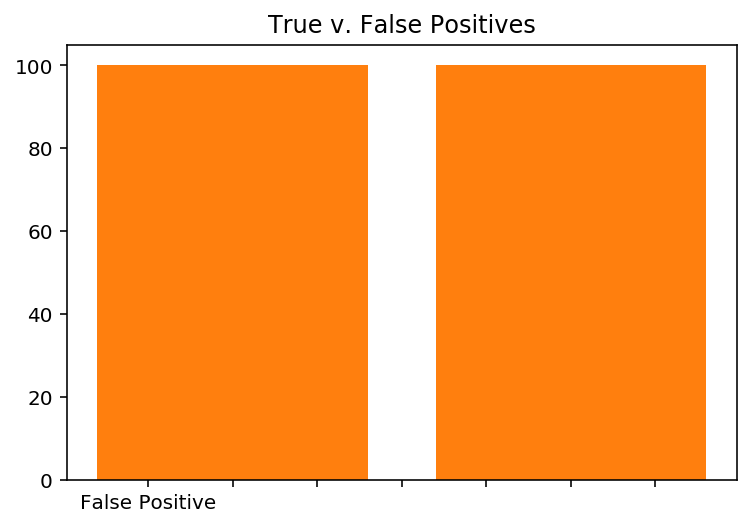

In [106]:
import numpy as np
import matplotlib.pyplot as plt


N = 2
# True Positives Bin
rf_tp = rf_tp
xgb_tp = xgb_tp
bbc_tp = bbc_tp
dt_tp = dt_tp
knn_tp = knn_tp

# False Positives Bin
rf_tn = rf_tn
xgb_tn = xgb_tn
bbc_tn = bbc_tn
dt_tn = dt_tn
knn_tn = knn_tn


fig, ax = plt.subplots()

ind = np.arange(N)    # the x locations for the groups
width = 0.35         # the width of the bars
p1 = ax.bar(ind, data = [rf_tp, xgb_tp, bbc_tp, dt_tp, knn_tp], height=100)

p2 = ax.bar(ind, data = [rf_fp, xgb_fp, bbc_fp, dt_fp, knn_fp], height=100)

ax.set_title('True v. False Positives')
# ax.set_xticks(ind + width / 2)
ax.set_xticklabels(('True Positive', 'False Positive'))

# ax.legend((p1[0], p2[0], p2[0], p3[0], p4[0]),
#           ('Random Forest', 'XGBoost', 'BBC', 'Decision Tree', 'KNN'))
# ax.yaxis.set_units(inch)
ax.autoscale_view()

plt.show()

In [122]:
confusion_df = pd.DataFrame(data=[confusion_matrix(y_test, yhat_rf).ravel(),
                   confusion_matrix(y_test, yhat_xgb).ravel(),
                   confusion_matrix(y_test, yhat_bbc).ravel(),
                   confusion_matrix(y_test, yhat_dt).ravel(),
                   confusion_matrix(y_test, yhat_knn).ravel()])

In [124]:
confusion_df.rename(index={0 : 'Random Forest',
                          1 : 'XGBoost',
                          2 : 'Balanced Bagging',
                          3 : 'Decision Tree',
                          4 : 'KNN'}, inplace=True)

In [126]:
confusion_df.rename(columns={0 : 'TN',
                            1 : 'FP',
                            2 : 'FN',
                            3 : 'TP'}, inplace=True)

In [127]:
confusion_df

,TN,FP,FN,TP
Random Forest,1242,8,11,33
XGBoost,1203,47,13,31
Balanced Bagging,1201,49,8,36
Decision Tree,1195,55,8,36
KNN,1157,93,11,33


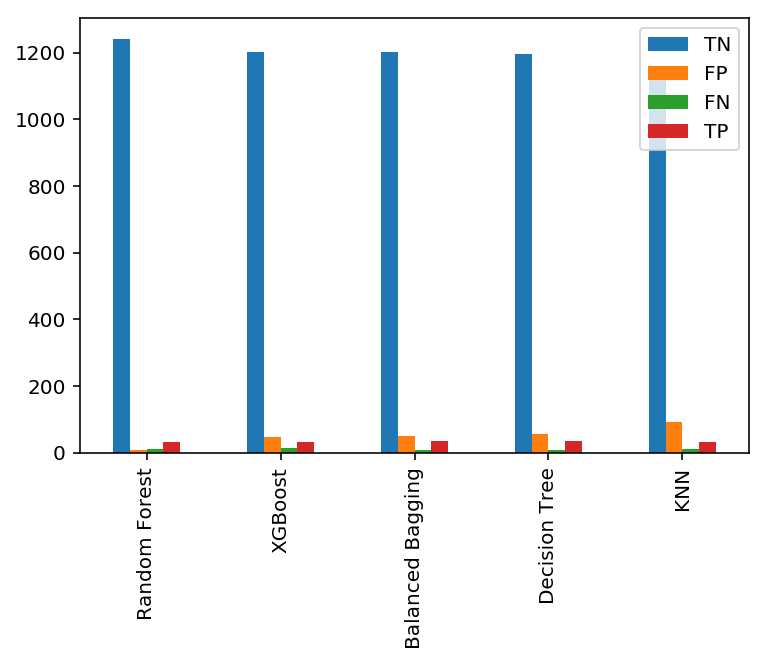

In [134]:
confusion_df.plot(kind='bar');

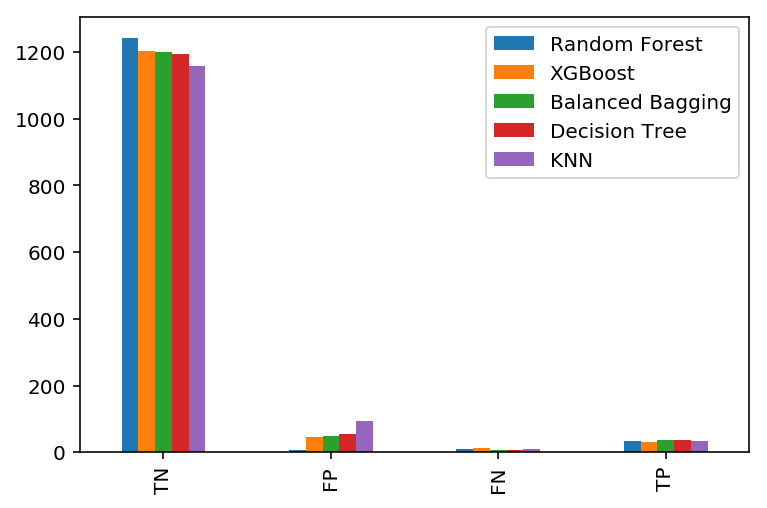

In [130]:
confusion_df.T.plot(kind='bar');